In [ ]:
pip install folium

In [ ]:
pip install sweetviz

#  ESCOPO DO PROJETO
1. Questões
2. Inicializando
3. Análise exploratória de dados (EDA)
4. Estimativa de Variabilidade
5. Testes de hipóteses
5. Análise de Texto: Usando técnicas de processamento de linguagem natural (NLP)
6. Síntese



# QUESTÕES

1. Fatores contribuintes para um preço relativamente alto

2. O que podemos discernir sobre as características de cada bairro usando as descrições dadas pelos anfitriões?

3. Em que  épocas do ano  os preços ficam mais altos ?
4. Esses preços tem relação com os bairros?

5. Qual é a taxa média de ocupação dos alojamentos do airbnb na Holanda?

6. Quais áreas/ tipos de alojamentos são mais populares na Holanda ?

7. Quais são os bairros mais caros e mais baratos para alugar via airbnb na Holanda ?

8. Quais são as características mais populares dos alojamentos  do airbnb?

# INICIANDO

In [ ]:
#importando as bibliotecas necessárias
%matplotlib inline
import pandas as pd
from wordcloud import WordCloud
import geopandas as gpd
import math
import numpy as np
import seaborn as sns
import numpy as np
from scipy.stats import pearsonr
from scipy.stats import spearmanr
import matplotlib.pyplot as plt
import folium
from folium import Choropleth, Marker
from folium.plugins import HeatMap, MarkerCluster

In [ ]:
#configurando o ambiente
from google.colab import drive
drive.mount('/content/drive')
#importando o dataset
df = pd.read_csv('/content/drive/MyDrive/Colab Notebooks/listings.csv.gz')


Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 6998 entries, 0 to 6997
Data columns (total 75 columns):
 #   Column                                        Non-Null Count  Dtype  
---  ------                                        --------------  -----  
 0   id                                            6998 non-null   int64  
 1   listing_url                                   6998 non-null   object 
 2   scrape_id                                     6998 non-null   int64  
 3   last_scraped                                  6998 non-null   object 
 4   source                                        6998 non-null   object 
 5   name                                          6998 non-null   object 
 6   description                                   6992 non-null   object 
 7   neighborhood_overview                         4506 non-null   object 
 8   picture_url                                   6998 non-null   object 
 9   host_id                                       6998 non-null   i

In [ ]:
#abrindo o dataset
df.head()

,id,listing_url,scrape_id,last_scraped,source,name,description,neighborhood_overview,picture_url,host_id,...,review_scores_communication,review_scores_location,review_scores_value,license,instant_bookable,calculated_host_listings_count,calculated_host_listings_count_entire_homes,calculated_host_listings_count_private_rooms,calculated_host_listings_count_shared_rooms,reviews_per_month
0,2818,https://www.airbnb.com/rooms/2818,20230309202119,2023-03-09,city scrape,Quiet Garden View Room & Super Fast Wi-Fi,Quiet Garden View Room & Super Fast Wi-Fi<br /...,"Indische Buurt (""Indies Neighborhood"") is a ne...",https://a0.muscache.com/pictures/10272854/8dcc...,3159,...,4.98,4.69,4.81,0363 5F3A 5684 6750 D14D,f,1,0,1,0,1.90
1,311124,https://www.airbnb.com/rooms/311124,20230309202119,2023-03-10,city scrape,*historic centre* *bright* *canal view* *jordaan*,> Please be so kind to book ONLY AFTER conta...,Perfect location in the lively centre. All his...,https://a0.muscache.com/pictures/5208672/5bb60...,1600010,...,4.92,4.93,4.60,0363 59D8 7D30 6CFA DC81,f,1,1,0,0,0.66
2,319985,https://www.airbnb.com/rooms/319985,20230309202119,2023-03-10,city scrape,Elegant Appartement Central Location.,"From December 26 thru January 2, minimum stay ...",Bij aankomst vertel ik mijn gasten graag over ...,https://a0.muscache.com/pictures/3b76222e-ed0a...,1640702,...,4.78,4.85,4.62,0363 7D88 E1E8 F521 9A10,f,2,1,1,0,3.73
3,327285,https://www.airbnb.com/rooms/327285,20230309202119,2023-03-10,city scrape,beautiful designed ap.+bikes+garden,Cosy and comfortable apartment on the ground f...,'De Pijp' as we Amsterdammers know it today is...,https://a0.muscache.com/pictures/4283713/63eaa...,1672823,...,4.99,4.91,4.84,0363 8A88 B129 62B5 BD4E,t,2,0,2,0,4.19
4,331946,https://www.airbnb.com/rooms/331946,20230309202119,2023-03-10,previous scrape,Lovely FAMILY house near Vondelpark,* Our house is only suitable for a couple or f...,NaN,https://a0.muscache.com/pictures/b73c16af-4e31...,1687595,...,4.88,4.79,4.75,0363 A942 21DC C431 1AD1,f,1,1,0,0,0.24


In [ ]:
# abrindo as últimas linhas do dataset
df.tail()

,id,listing_url,scrape_id,last_scraped,source,name,description,neighborhood_overview,picture_url,host_id,...,review_scores_communication,review_scores_location,review_scores_value,license,instant_bookable,calculated_host_listings_count,calculated_host_listings_count_entire_homes,calculated_host_listings_count_private_rooms,calculated_host_listings_count_shared_rooms,reviews_per_month
6993,842462220391708128,https://www.airbnb.com/rooms/842462220391708128,20230309202119,2023-03-10,city scrape,Flat in the center of Amsterdam,Our place is the really best place you can pic...,"Stay in the middle of Amsterdam. Bikes around,...",https://a0.muscache.com/pictures/miso/Hosting-...,47205615,...,NaN,NaN,NaN,0363 80A2 E913 8FAD A98A,f,1,1,0,0,NaN
6994,842493348876281257,https://www.airbnb.com/rooms/842493348876281257,20230309202119,2023-03-09,city scrape,3bed ark close to city centre,"At NDSM, the arty heart of the city, you can f...",NaN,https://a0.muscache.com/pictures/miso/Hosting-...,454835217,...,NaN,NaN,NaN,0363 B755 6BD8 6F8D AA7F,t,1,1,0,0,NaN
6995,842634905680862660,https://www.airbnb.com/rooms/842634905680862660,20230309202119,2023-03-10,city scrape,ground floor studio 46m2 at boulevard & canal,Studio in a newly build house. Entrance at the...,NaN,https://a0.muscache.com/pictures/miso/Hosting-...,504448710,...,NaN,NaN,NaN,0363 76A0 B46B 281A C38E,f,1,1,0,0,NaN
6996,842713539293550316,https://www.airbnb.com/rooms/842713539293550316,20230309202119,2023-03-09,city scrape,Oasis in trendy Amsterdam East,"Design appartement met fijne tuin, in een van ...",NaN,https://a0.muscache.com/pictures/miso/Hosting-...,17537276,...,NaN,NaN,NaN,0363 97C2 71FF 5383 DC95,f,1,1,0,0,NaN
6997,842754604161195632,https://www.airbnb.com/rooms/842754604161195632,20230309202119,2023-03-09,city scrape,Penthouse Loft with a View,Beautiful 2 bedroom 1 bathroom top floor apart...,NaN,https://a0.muscache.com/pictures/miso/Hosting-...,20336096,...,NaN,NaN,NaN,0363 A514 512A A671 03A3,f,1,1,0,0,NaN


In [ ]:
#observando a proporção do dataset
df.shape

(6998, 75)

O dataset é composto por 6998 linhas e 75 colunas

In [ ]:
#Observando as colunas
df.columns

Index(['id', 'listing_url', 'scrape_id', 'last_scraped', 'source', 'name',
       'description', 'neighborhood_overview', 'picture_url', 'host_id',
       'host_url', 'host_name', 'host_since', 'host_location', 'host_about',
       'host_response_time', 'host_response_rate', 'host_acceptance_rate',
       'host_is_superhost', 'host_thumbnail_url', 'host_picture_url',
       'host_neighbourhood', 'host_listings_count',
       'host_total_listings_count', 'host_verifications',
       'host_has_profile_pic', 'host_identity_verified', 'neighbourhood',
       'neighbourhood_cleansed', 'neighbourhood_group_cleansed', 'latitude',
       'longitude', 'property_type', 'room_type', 'accommodates', 'bathrooms',
       'bathrooms_text', 'bedrooms', 'beds', 'amenities', 'price',
       'minimum_nights', 'maximum_nights', 'minimum_minimum_nights',
       'maximum_minimum_nights', 'minimum_maximum_nights',
       'maximum_maximum_nights', 'minimum_nights_avg_ntm',
       'maximum_nights_avg_ntm', 'ca




---


# DICIONÁRIO DOS DADOS



id: Identificador único para cada registro de hospedagem.

listing_url: URL do anúncio da hospedagem.

scrape_id: Identificador único para a raspagem (coleta) de dados.

last_scraped: Data da última coleta de dados.

source: Fonte da qual os dados foram obtidos.

name: Nome da hospedagem.

description: Descrição detalhada da hospedagem.

neighborhood_overview: Visão geral do bairro onde a hospedagem está localizada.

picture_url: URL da imagem da hospedagem.

host_id: Identificador único do anfitrião (proprietário da hospedagem).

host_url: URL do perfil do anfitrião.

host_name: Nome do anfitrião.


host_since: Data em que o anfitrião se cadastrou na plataforma.

host_location: Localização do anfitrião.

host_about: Informações sobre o anfitrião.

host_response_time: Tempo médio de resposta do anfitrião.

host_response_rate: Taxa de resposta do anfitrião.

host_acceptance_rate: Taxa de aceitação de reservas pelo anfitrião.

host_is_superhost: Indica se o anfitrião é um "superhost" (status de destaque na plataforma).

host_thumbnail_url: URL da foto de perfil do anfitrião.


host_picture_url: URL da imagem do anfitrião.



host_neighbourhood: Bairro onde o anfitrião reside.


host_listings_count: Número total de anúncios de hospedagem do anfitrião.


host_total_listings_count: Número total de anúncios de hospedagem do anfitrião (igual ao anterior).

host_verifications: Métodos de verificação do anfitrião.


host_has_profile_pic: Indica se o anfitrião possui uma foto de perfil.


host_identity_verified: Indica se a identidade do anfitrião foi verificada.


neighbourhood: Bairro onde a hospedagem está localizada.


neighbourhood_cleansed: Bairro da hospedagem após limpeza (pode ser diferente do bairro original).


neighbourhood_group_cleansed: Grupo de bairros após limpeza (pode ser nulo).


latitude: Latitude da localização da hospedagem.


longitude: Longitude da localização da hospedagem.



property_type: Tipo de propriedade da hospedagem (ex: apartamento, casa, etc.).


room_type: Tipo de quarto (ex: quarto privado, quarto compartilhado, casa inteira, etc.).


accommodates: Número de hóspedes que a hospedagem acomoda.


bathrooms: Número de banheiros (pode ser nulo).



bathrooms_text: Descrição dos banheiros (texto).



bedrooms: Número de quartos.



beds: Número de camas.


amenities: Comodidades oferecidas na hospedagem.



price: Preço da hospedagem por noite.



minimum_nights: Número mínimo de noites para reservar.



maximum_nights: Número máximo de noites para reservar.


minimum_minimum_nights: Mínimo de noites permitidas por reserva.



maximum_minimum_nights: Máximo de noites permitidas por reserva.



minimum_maximum_nights: Mínimo de noites permitidas para estadias mais longas.



maximum_maximum_nights: Máximo de noites permitidas para estadias mais longas.




minimum_nights_avg_ntm: Média mínima de noites permitidas para estadias não temporárias.



maximum_nights_avg_ntm: Média máxima de noites permitidas para estadias não temporárias.


calendar_updated: Informação sobre a última atualização do calendário (pode ser nulo).



has_availability: Indica se a hospedagem tem disponibilidade.



availability_30: Número de dias de disponibilidade nos próximos 30 dias.



availability_60: Número de dias de disponibilidade nos próximos 60 dias.




availability_90: Número de dias de disponibilidade nos próximos 90 dias.



availability_365: Número de dias de disponibilidade ao longo do ano.



calendar_last_scraped: Data da última raspagem do calendário (pode ser nulo).



number_of_reviews: Número total de avaliações da hospedagem.



number_of_reviews_ltm: Número de avaliações no último ano.




number_of_reviews_l30d: Número de avaliações nos últimos 30 dias.



first_review: Data da primeira avaliação.




last_review: Data da última avaliação.



review_scores_rating: Pontuação média das avaliações.



review_scores_accuracy: Pontuação média de precisão nas avaliações.



review_scores_cleanliness: Pontuação média de limpeza nas avaliações.


review_scores_checkin: Pontuação média de check-in nas avaliações.


review_scores_communication: Pontuação média de comunicação nas avaliações.




review_scores_location: Pontuação média de localização nas avaliações.




review_scores_value: Pontuação média de valor nas avaliações.




license: Licença da hospedagem (pode ser nulo).

instant_bookable: Indica se a hospedagem pode ser reservada instantaneamente.



calculated_host_listings_count: Número de anúncios de hospedagem do mesmo anfitrião.



calculated_host_listings_count_entire_homes: Número de anúncios de hospedagem de casas inteiras do mesmo anfitrião.




calculated_host_listings_count_private_rooms: Número de anúncios de hospedagem de quartos privados do mesmo anfitrião.



calculated_host_listings_count_shared_rooms: Número de anúncios de hospedagem de quartos compartilhados do mesmo anfitrião.




reviews_per_month: Número médio de avaliações por mês.







---

# EDA

In [ ]:
df.describe()

,id,scrape_id,host_id,host_listings_count,host_total_listings_count,neighbourhood_group_cleansed,latitude,longitude,accommodates,bathrooms,...,review_scores_cleanliness,review_scores_checkin,review_scores_communication,review_scores_location,review_scores_value,calculated_host_listings_count,calculated_host_listings_count_entire_homes,calculated_host_listings_count_private_rooms,calculated_host_listings_count_shared_rooms,reviews_per_month
count,6.998000e+03,6.998000e+03,6.998000e+03,6998.000000,6998.000000,0.0,6998.000000,6998.000000,6998.000000,0.0,...,6312.000000,6312.000000,6312.000000,6312.000000,6312.000000,6998.000000,6998.000000,6998.000000,6998.000000,6316.000000
mean,1.868001e+17,2.023031e+13,1.001616e+08,2.480280,4.438983,NaN,52.366767,4.890218,2.908260,NaN,...,4.759781,4.878554,4.890019,4.788021,4.640970,1.806516,1.023149,0.693055,0.039869,1.134069
std,3.138377e+17,0.000000e+00,1.356648e+08,12.798773,26.261102,NaN,0.017055,0.035085,1.387231,NaN,...,0.323061,0.233375,0.234914,0.252756,0.321297,2.474394,1.386672,1.939071,0.448247,2.396285
min,2.818000e+03,2.023031e+13,3.159000e+03,1.000000,1.000000,NaN,52.290340,4.755710,0.000000,NaN,...,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,0.000000,0.000000,0.000000,0.010000
25%,1.578534e+07,2.023031e+13,9.506638e+06,1.000000,1.000000,NaN,52.355979,4.866687,2.000000,NaN,...,4.670000,4.850000,4.870000,4.670000,4.500000,1.000000,1.000000,0.000000,0.000000,0.270000
50%,3.534389e+07,2.023031e+13,3.403882e+07,1.000000,1.000000,NaN,52.366065,4.888160,2.000000,NaN,...,4.860000,4.950000,4.970000,4.860000,4.690000,1.000000,1.000000,0.000000,0.000000,0.530000
75%,5.821187e+17,2.023031e+13,1.354875e+08,2.000000,3.000000,NaN,52.376540,4.908185,4.000000,NaN,...,5.000000,5.000000,5.000000,5.000000,4.830000,1.000000,1.000000,1.000000,0.000000,1.170000
max,8.427546e+17,2.023031e+13,5.044487e+08,522.000000,699.000000,NaN,52.425120,5.026430,16.000000,NaN,...,5.000000,5.000000,5.000000,5.000000,5.000000,22.000000,14.000000,20.000000,8.000000,111.590000


count: o número de linhas no DataFrame. Neste caso, há 2.000.000 linhas.
mean: a média dos valores na coluna. Neste caso, a média do número de avaliações é 4.889.

std: a variância dos valores na coluna. Neste caso, a variância do número de avaliações é 0.056873.

min: o valor mínimo na coluna. Neste caso, o valor mínimo do número de avaliações é 4.848790.

25%: o 25º percentil dos valores na coluna. Neste caso, o 25º percentil do número de avaliações é 4.868898.

50%: o 50º percentil dos valores na coluna. Neste caso, o 50º percentil do número de avaliações é 4.889005.

75%: o 75º percentil dos valores na coluna. Neste caso, o 75º percentil do número de avaliações é 4.909112.

max: o valor máximo na coluna. Neste caso, o valor máximo do número de avaliações é 4.929220.


In [ ]:
# observando os valores nulos
columns_with_miss = df.isna().sum()
#filtrando apenas as colunas com pelo menos 1 valor ausente
columns_with_miss = columns_with_miss[columns_with_miss!=0]
#número de colunas com valores ausentes
print('Columns with missing values:', len(columns_with_miss))
#classificando as colunas pelo número de valores ausentes em ordem decrescente
columns_with_miss.sort_values(ascending=False)




Columns with missing values: 27


neighbourhood_group_cleansed    6998
calendar_updated                6998
bathrooms                       6998
host_neighbourhood              4022
host_about                      2915
neighborhood_overview           2492
neighbourhood                   2492
host_response_time              2039
host_response_rate              2039
host_acceptance_rate             995
host_location                    803
review_scores_accuracy           686
review_scores_communication      686
review_scores_cleanliness        686
review_scores_location           686
review_scores_checkin            686
review_scores_value              686
first_review                     682
last_review                      682
review_scores_rating             682
reviews_per_month                682
bedrooms                         284
beds                              85
license                           24
bathrooms_text                    13
description                        6
host_is_superhost                  4
d

In [ ]:
#Porcentagem de valores nulos por coluna
df.isna().sum()/df.shape[0]

id                                              0.000000
listing_url                                     0.000000
scrape_id                                       0.000000
last_scraped                                    0.000000
source                                          0.000000
                                                  ...   
calculated_host_listings_count                  0.000000
calculated_host_listings_count_entire_homes     0.000000
calculated_host_listings_count_private_rooms    0.000000
calculated_host_listings_count_shared_rooms     0.000000
reviews_per_month                               0.097456
Length: 75, dtype: float64

Temos  na coluna reviews_per_month  97% dos valores nulos

---



---



In [ ]:
#dropando a coluna reviews_per_month
df.drop('reviews_per_month', axis=1, inplace=True)


In [ ]:
#dados duplicados
df.duplicated().sum()


0

In [ ]:
# obtendo informações sobre o maior valor de um airbnb
preco_maximo = df['price'].max()
print(f'O preço máximo na coluna "price" é: {preco_maximo}')


O preço máximo na coluna "price" é: $999.00


In [ ]:
df['price'] = df['price'].astype(str)

# Removendo os caracteres não numéricos da coluna de preços e fazendo a conversão
df['price'] = df['price'].str.replace('[\$,]', '', regex=True).astype(float)

# Calcule o preço médio
preco_medio = df['price'].mean()
print(f'O preço médio dos Airbnbs é ${preco_medio:.2f}')

O preço médio dos Airbnbs é $223.04


In [ ]:
#Quantas linhas possui valores únicos?
df['price'].nunique()

557

In [ ]:
#obtendo informações sobre o menor valor de um airbnb
preco_minimo = df['price'].min()
print(f'O preço mínimo na coluna "price" é: {preco_minimo}')

O preço mínimo na coluna "price" é: 0.0


In [ ]:
#Quantas linhas possui valores minímos?
df['price'].value_counts().min()

1

In [ ]:
#Quantas linhas possui valores máximos?
df['price'].value_counts().max()

272

In [ ]:
#Tipo de hospedagem mais alugado
df['room_type'].value_counts()

Entire home/apt    5154
Private room       1743
Hotel room           62
Shared room          39
Name: room_type, dtype: int64

# Estimativas de Variabilidade




In [ ]:
#calculando a variância da coluna preço

variance = df['price'].var()
print ("price Variância da coluna 'price'", variance)

price Variância da coluna 'price' 32767.682925230318


A variância é uma medida da dispersão dos dados em torno da média. No caso da coluna "price", a variância de 32767.682925230318 significa que os preços dos apartamentos em Amsterdã tem uma grande diferença entre os preços mais baixos e os preços mais altos.

# Análise Descritiva Variável (Price)

In [ ]:
mean_price = df['price'].mean()
median_price = df['price'].median()
std_price = df['price'].std()

print(f'Média de Preços: {mean_price}')
print(f'Mediana de Preços: {median_price}')
print(f'Desvio Padrão de Preços: {std_price}')



Média de Preços: 223.03886824807088
Mediana de Preços: 186.0
Desvio Padrão de Preços: 181.0184601780446


# Correlação

In [ ]:
correlation = df.corr()
print('\nMatriz de Correlação:')
print(correlation)


Matriz de Correlação:
                                                    id  scrape_id   host_id  \
id                                            1.000000        NaN  0.255979   
scrape_id                                          NaN        NaN       NaN   
host_id                                       0.255979        NaN  1.000000   
host_listings_count                           0.001433        NaN  0.070614   
host_total_listings_count                    -0.008462        NaN  0.011487   
neighbourhood_group_cleansed                       NaN        NaN       NaN   
latitude                                     -0.042347        NaN -0.014917   
longitude                                    -0.036953        NaN -0.010740   
accommodates                                 -0.007973        NaN -0.026696   
bathrooms                                          NaN        NaN       NaN   
bedrooms                                     -0.018291        NaN -0.083561   
beds                         

<ipython-input-769-68fd408fbee4>:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  correlation = df.corr()


UM POUCO DA INTERPRETAÇÃO DAS CORRELAÇÕES , NÃO IREI INTERPRETAR TUDO PARA NÃO PROLONGAR AINDA MAIS  .

maximum_nights tem uma correlação negativa moderada com price, indicando que um número máximo menor de noites permitidas está associado a preços mais altos.

minimum_maximum_nights tem uma correlação negativa forte com price, o que sugere que um número mínimo menor de noites permitidas para estadias mais longas está associado a preços mais altos.


number_of_reviews tem uma correlação negativa moderada com price, o que indica que preços mais baixos podem estar associados a mais avaliações. Isso pode ser interpretado de várias maneiras, como hospedagens mais baratas atraindo mais hóspedes ou mais avaliações levando a preços mais baixos.

availability_30, availability_60, availability_90, e availability_365 têm correlações positivas com price  (Baseado nisso irei fazer um teste de hipótese abaixo)

# Testes de Hipotéses

In [ ]:
from scipy.stats import pearsonr, t
# Calcula o coeficiente de correlação
correlation = np.corrcoef(df["price"], df["review_scores_value"])[0, 1]

# Calcula o valor crítico
t_critical = t.ppf(1 - 0.05 / 2, len(df) - 2)

# Realiza o teste de hipótese
if abs(correlation) > t_critical:
    print("Rejeite a hipótese nula (H0)")
    print("Existe uma correlação significativa entre preço e review_scores_value.")

else:
 print("Falha ao rejeitar a hipótese nula (H0)")
 print("Não há correlação significativa entre preço e review_scores_value.")

Falha ao rejeitar a hipótese nula (H0)
Não há correlação significativa entre preço e review_scores_value.


In [ ]:
var = ["availability_30","availability_60","availability_90","availability_365"]

# nível de significância

alpha = 0.05

for var in var:
  #calculando o coeficiente de correlação
  correlation, _ = pearsonr(df[var],df["price"])

  #teste de hipótese

  if correlation > 0:
    print(f"A variável '{var}' tem uma correlação positiva com o preço.")
  else:
    print(f"A variável '{var}' não tem uma correlação positiva com o preço.")


A variável 'availability_30' tem uma correlação positiva com o preço.
A variável 'availability_60' tem uma correlação positiva com o preço.
A variável 'availability_90' tem uma correlação positiva com o preço.
A variável 'availability_365' tem uma correlação positiva com o preço.


Isso significa que quanto mais disponibilidade a curto ou longo prazo, em geral, os preços são mais elevados.

# Vamos visualizar?

In [ ]:
#Convertendo a coluna 'price' para um formato numérico (removendo símbolos de moeda)
if df['price'].dtype == object:
    df['price'] = df['price'].str.replace('$', '').str.replace(',', '').astype(float)


In [ ]:
#extraindo o mês do registro da data e criando uma nova coluna 'month'
df['month'] = pd.to_datetime(df['last_review']).dt.month

# Em que épocas do ano os preços ficam mais altos ?

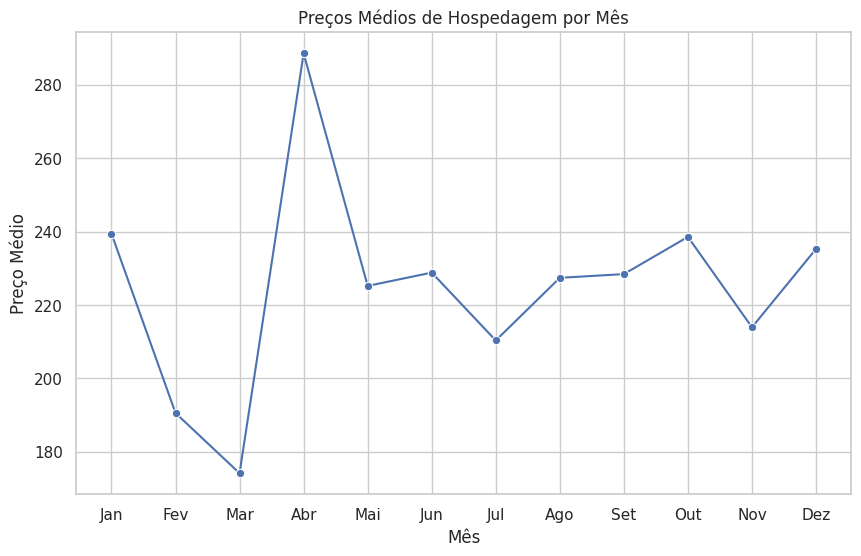

In [ ]:
#Observando o preço médio de hospedagens mensalmente
monthly_prices = df.groupby('month')['price'].mean()
plt.figure(figsize=(10, 6))
sns.lineplot(x=monthly_prices.index, y=monthly_prices.values, marker='o')
plt.title('Preços Médios de Hospedagem por Mês')
plt.xlabel('Mês')
plt.ylabel('Preço Médio')
plt.xticks(range(1, 13), ['Jan', 'Fev', 'Mar', 'Abr', 'Mai', 'Jun', 'Jul', 'Ago', 'Set', 'Out', 'Nov', 'Dez'])
plt.show()



 Podemos ver um pico no mês de abril , Isso ocorre porque abril é  primavera, quando as cidades ficam mais coloridas e floridas. Além disso, a temperatura durante a primavera é mais amena, o que atrai turistas de todo o mundo.
 E os preços tendem a aumentar bastante como podemos ver .
Também é comemorado o dia da Páscoa ,  além do dia do Rei que é uma festa bastante importante para os Holandeses .

---


Sob outro enfoque,  o mês de maio tem uma queda abrupta nos valores .

A transição das estações somada ao início do ano letivo contribui para que Março seja um  mês que os valores sejam mais baixos . Então quem deseja pagar mais barato e encontrar a cidade mais vazia é uma ótima oportunidade.

---


Conselho : Planeje sua viagem bem antes !


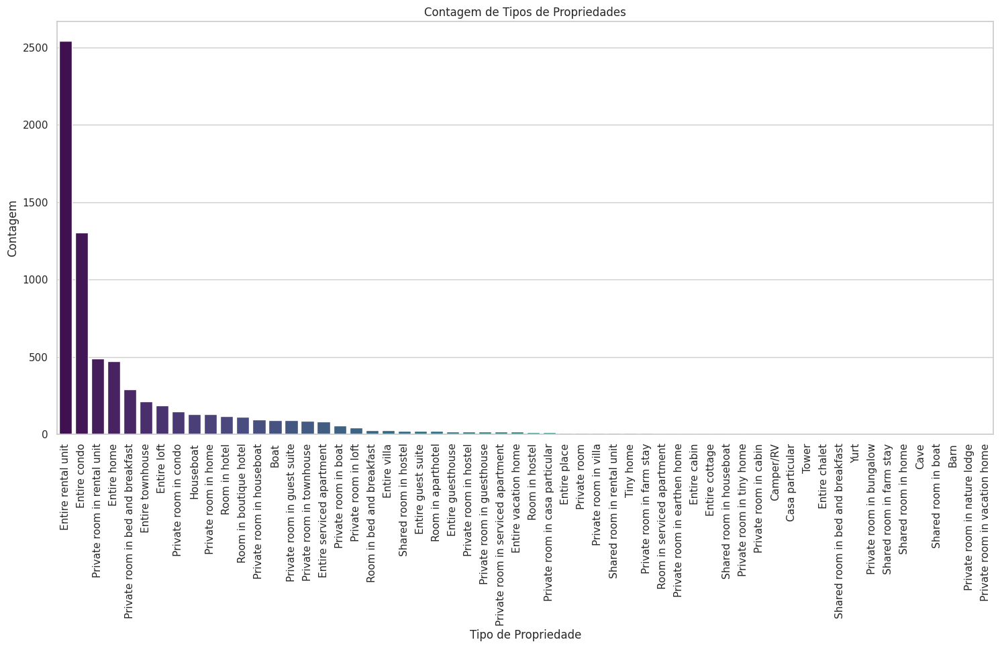

In [ ]:
#Visualizando tipos de Hostels
property_counts = df['property_type'].value_counts()
plt.figure(figsize=(18, 8))
sns.barplot(x=property_counts.index, y=property_counts.values, palette='viridis')
plt.title('Contagem de Tipos de Propriedades')
plt.xlabel('Tipo de Propriedade')
plt.ylabel('Contagem')
plt.xticks(rotation=90)
plt.show()

Através da visualização é possívél afirmar que os tipos de propiedade mais comuns são : Espaço inteiro isso é(sem espaços compartilhados)

condomínio inteiro

quarto privativo

casa inteira

quarto privado com alojamento pequeno

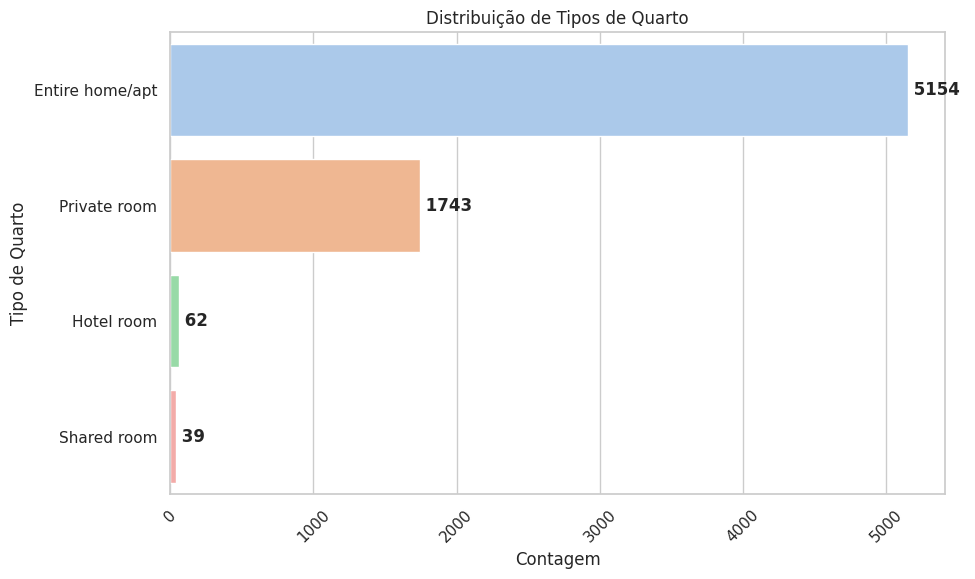

In [ ]:
# visualizando como os quartos estão distribuidos
room_type_counts = df['room_type'].value_counts()

# vamos dar uma corzinha
colors = sns.color_palette('pastel')

# optei por um  gráfico de barras com Seaborn
plt.figure(figsize=(10, 6))
sns.set_style("whitegrid")  # dando um estilo ao  gráfico

# gráfico de barras horizontal
sns.barplot(x=room_type_counts.values, y=room_type_counts.index, palette=colors)

# título
plt.title("Distribuição de Tipos de Quarto")

# Rotacionando os rótulos do eixo y para melhorar a legibilidade
plt.xticks(rotation=45)

# Adicionando rótulos aos valores nas barras
for i, count in enumerate(room_type_counts):
    plt.text(count, i, f' {count} ', va='center', fontsize=12, fontweight='bold')

# fazendo a magia acontecer (brincadeira)
plt.xlabel("Contagem")
plt.ylabel("Tipo de Quarto")
plt.show()


Através da análise é possível visualisar numericamente os  tipos airbnb mais alugados .

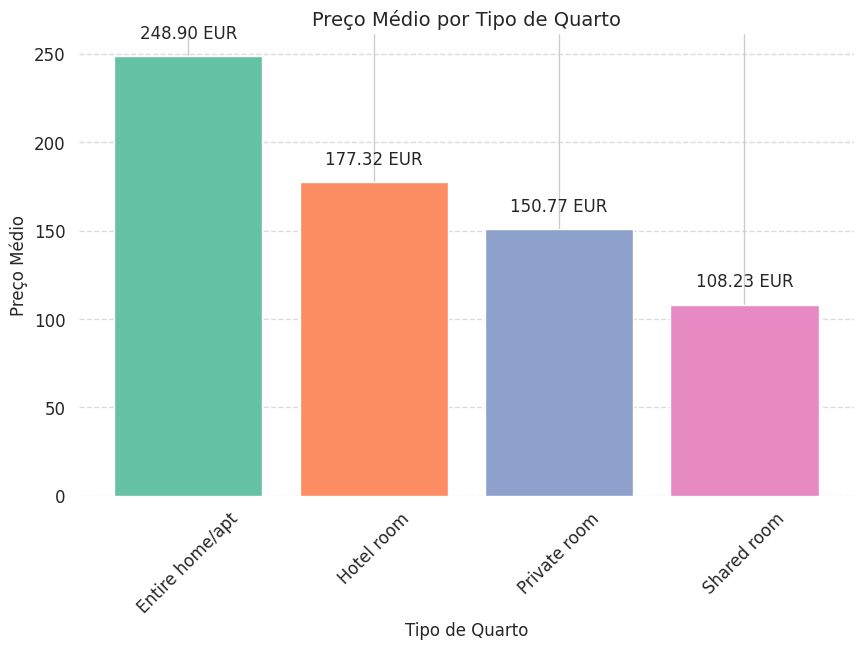

In [ ]:
#  visualizando os quartos agora por preço médio
room_type_prices = df.groupby('room_type')['price'].mean().reset_index()

# Ordenando os dados por preço médio
room_type_prices = room_type_prices.sort_values(by='price', ascending=False)

# estilizando
sns.set(style="whitegrid")

# Criando o gráfico de barras com cores personalizadas
plt.figure(figsize=(10, 6))
colors = sns.color_palette("Set2", len(room_type_prices))
plt.bar(room_type_prices['room_type'], room_type_prices['price'], color=colors)
plt.xlabel('Tipo de Quarto')
plt.ylabel('Preço Médio')
plt.title('Preço Médio por Tipo de Quarto', fontsize=14)
plt.xticks(rotation=45, fontsize=12)
plt.yticks(fontsize=12)
plt.grid(axis='y', linestyle='--', alpha=0.7)

# Adicionando os rótulos de preço aos topos das barras
for i, v in enumerate(room_type_prices['price']):
    plt.text(i, v + 10, f'{v:.2f} EUR', ha='center', fontsize=12)

# Removendo a moldura do gráfico
sns.despine(left=True, bottom=True)
#abrindo
plt.show()

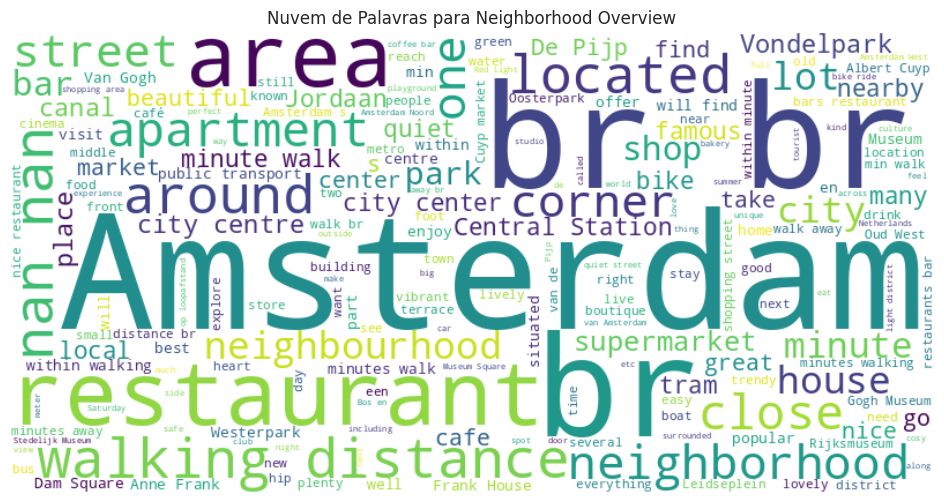

In [ ]:
#Visualizando através de uma nuvem de palavras a variável neighborhood_overview
# Combinando todas as palavras da coluna 'neighborhood_overview' em uma única string
overview_text = " ".join(str(text) for text in df['neighborhood_overview'])

# Criando a nuvem de palavra para a variável neighborhood_overview
wordcloud = WordCloud(width=800, height=400, background_color='white').generate(overview_text)

# abrindo
plt.figure(figsize=(12, 6))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis("off")
plt.title("Nuvem de Palavras para Neighborhood Overview")
plt.show()

Como podem ver essas são as palavras mais repetidas no que diz respeito a variável (neighborhood_overview)

In [ ]:
df['description'].fillna('Sem descrição', inplace=True)
df['amenities'].fillna('Sem comodidades', inplace=True)

# Criando um mapa  interativo (Folium)
m = folium.Map(location=[df['latitude'].mean(), df['longitude'].mean()], zoom_start=11)

# Adicionando marcadores ao mapa com informações personalizadas, assim quando vc clicar as respectivas descrições apareceram na tela
for _, row in df.iterrows():
    popup = f"<strong>Descrição:</strong> {row['description']}<br><strong>Preço:</strong> {row['price']} EUR<br><strong>Comodidades:</strong> {row['amenities']}"
    folium.Marker(
        location=(row['latitude'], row['longitude']),
        popup=folium.Popup(popup, parse_html=True),
    ).add_to(m)

# abrindo
m

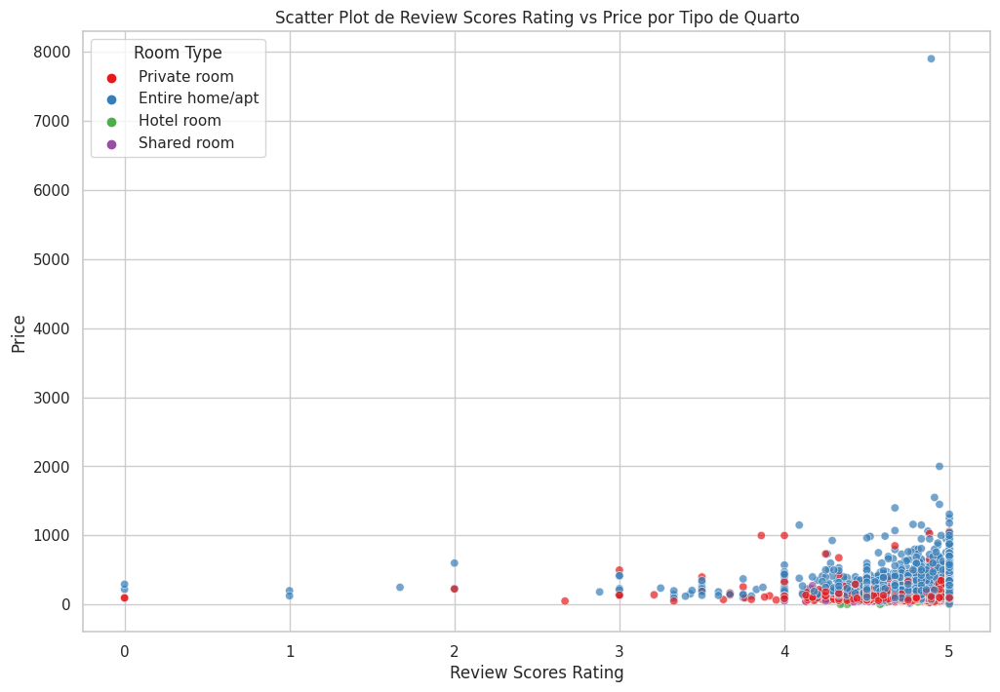

In [ ]:
sns.set(style="whitegrid")

# gráfico de dispersão  de acordo com a tipagem do airbnb,  preço e review
plt.figure(figsize=(12, 8))
sns.scatterplot(data=df, x='review_scores_rating', y='price', hue='room_type', alpha=0.7, palette='Set1')

# rótulos e título
plt.xlabel('Review Scores Rating')
plt.ylabel('Price')
plt.title('Scatter Plot de Review Scores Rating vs Price por Tipo de Quarto')

# legenda
plt.legend(title='Room Type')

# abrir
plt.show()

Através da visualização acima é possível afirmar que quartos compartilhados (os pontinhos roxos) tendem a ter reviews entre 4 e 5

In [ ]:
# correlação entre os preços  e as informações dos anfitriões
# Preencha valores nulos na coluna 'host_about'
df['host_about'].fillna('Sem Informações', inplace=True)

# Converta a coluna 'host_about' em uma variável numérica (por exemplo, contagem de palavras)
df['host_about_length'] = df['host_about'].str.len()

# Calcule a correlação de Spearman
correlation_spearman, _ = spearmanr(df['host_about_length'], df['price'])
print(f"Correlação de Spearman: {correlation_spearman}")

Correlação de Spearman: -0.0677784839866056


A correlação é próxima de 0, o que sugere que não existe uma correlação forte entre o preço das hospedagens e as informações sobre o anfitrião.

O sinal negativo (-0.0678) sugere uma pequena tendência de que, à medida que o comprimento das informações do anfitrião aumenta, o preço pode diminuir ligeiramente. No entanto, essa tendência é fraca e não é uma relação forte.

In [ ]:
# observando mais a coluna (descrição da vizinhança) especificamente linha 10
df['neighborhood_overview'][10]

'The Amsterdam Canal District is a neighbourhood in Amsterdam, Netherlands. The seventeenth-century canals of Amsterdam, located in the center of Amsterdam, were added to the UNESCO World Heritage List in August 2010. The Amsterdam Canal District consists of the area around the city’s four main canals: Singel, Herengracht, Keizersgracht, and Prinsengracht. From Brouwersgracht, the canals are generally parallel with one another, in a semi-horseshoe shape, leading gradually southeast into the Amstel river.'



---
"O Amsterdam Canal District é um bairro de Amsterdã, Holanda. Os canais de Amsterdã do século XVII, localizados no centro de Amsterdã, foram adicionados à Lista do Patrimônio Mundial da UNESCO em agosto de 2010. O Distrito dos Canais de Amsterdã consiste na área ao redor dos quatro canais principais da cidade: Singel, Herengracht, Keizersgracht e Prinsengracht. . A partir de Brouwersgracht, os canais são geralmente paralelos entre si, em formato de semi-ferradura, levando gradualmente para sudeste até o rio Amstel."


In [ ]:
#distribuição do preço
df["price"].value_counts(normalize = True)

200.0    0.038868
150.0    0.037868
250.0    0.031723
300.0    0.024864
175.0    0.019148
           ...   
960.0    0.000143
485.0    0.000143
656.0    0.000143
227.0    0.000143
620.0    0.000143
Name: price, Length: 557, dtype: float64

38% dos preços giram em torno de $200.00

37% dos preços giram em torno de $150.00

31% dos preços giram em torno de $250.00

24% dos preços giram em torno de $300.00

19% dos preços giram em torno de $175.00

In [ ]:
#aluguéis por bairros
df['neighbourhood'].value_counts()

Amsterdam, Noord-Holland, Netherlands                          3659
Amsterdam, North Holland, Netherlands                           515
Amsterdam, NH, Netherlands                                      184
Amsterdam, Netherlands                                           45
Amsterdam-Zuidoost, Noord-Holland, Netherlands                   16
Amsterdam, Nord Holland, Netherlands                             14
Amsterdam-Zuidoost, North Holland, Netherlands                    8
Amsterdam, Noord Holland, Netherlands                             7
Amsterdam, LC, Netherlands                                        6
Lijnden, Noord-Holland, Netherlands                               3
Amsterdam Zuid-Oost, Noord-Holland, Netherlands                   3
Amsterdam, Haarlemmerbuurt, Netherlands                           2
Ouder-Amstel, Noord-Holland, Netherlands                          2
Netherlands                                                       2
Amsterdam, Holland, Netherlands                 

Através da análise é possivél afirmar que o bairro onde mais alugam hospedagem é Amsterdam Noord sendo 3659 .

Esse bairro é um bairro muito badalado onde a natureza, as tradições e a modernidade se encontram, acessíveis em questão de minutos graças aos serviços gratuitos de balsa da cidade. Noord não apenas possui extensas áreas verdes repletas de belas flora e fauna, mas a arquitetura está entre as mais atuais e impressionantes da cidade. De cafés da moda e hotéis exclusivos a marcos renomados e uma cena de startups de ponta, Noord tem algo para todos.

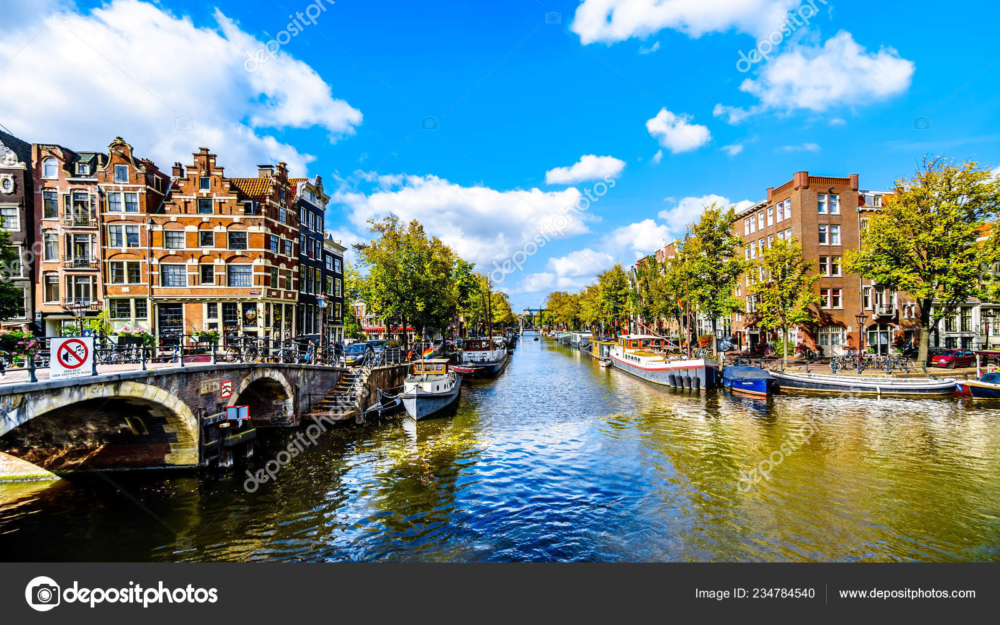

Em segundo lugar , o bairro que mais alugam hospedagem é Amsterdam, North Holland, Netherlands , sendo 515.


E em terceiro lugar Amsterdam, NH, Netherlands , sendo Amsterdam, NH, Netherlands  .


---



#  Preço médio por bairro

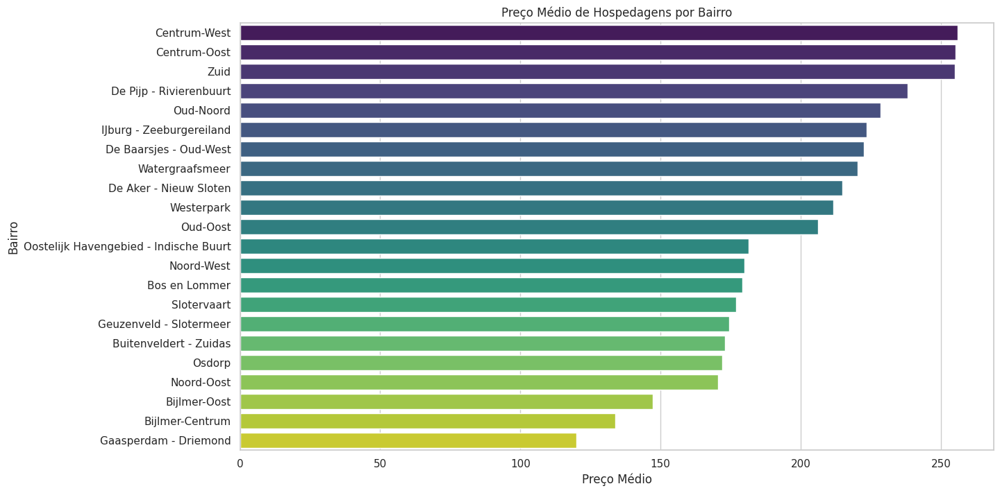

In [ ]:
plt.figure(figsize=(14, 8))

# Calcule a média dos preços por bairro
average_prices_by_neighborhood = df.groupby('neighbourhood_cleansed')['price'].mean().sort_values(ascending=False)

# Crie um gráfico de barras
sns.barplot(x=average_prices_by_neighborhood.values, y=average_prices_by_neighborhood.index, palette='viridis')

# Defina rótulos e título
plt.xlabel('Preço Médio')
plt.ylabel('Bairro')
plt.title('Preço Médio de Hospedagens por Bairro')

# Exiba o gráfico
plt.show()

O gráfico mostra que os bairros do centro da cidade são os mais caros, com preços médios de hospedagem acima de 200 euros por noite. Os bairros mais baratos ficam na zona leste, com preços médios abaixo de 100 euros por noite.






In [ ]:
# visualizando mapa de Amsterdã com marcadores nos locais das listagens do Airbnb.
# Os marcadores são agrupados para tornar o mapa com uma leitura mais fácil.
m_3 = folium.Map(location=[52.37,4.89], tiles='cartodbpositron', zoom_start=12)

mc = MarkerCluster()
for idx, row in df.iterrows():
    if not math.isnan(row['longitude']) and not math.isnan(row['latitude']):
        mc.add_child(Marker([row['latitude'], row['longitude']]))
m_3.add_child(mc)

m_3

In [ ]:
#definindo o mapa centrado no Amsterdam, Noord-Holland, Netherlands   com um nível de zoom baixo
world_map = folium.Map(location=[52.377956, 4.897070], zoom_start=8)
world_map


# Qual é a taxa média de ocupação dos alojamentos do Airbnb na Holanda?

In [ ]:
# Filtrando os alojamentos na Holanda
df = df.loc[df['neighbourhood'] == 'Netherlands']

# Calculando a taxa de ocupação média
occupancy_rate = df['availability_365'].mean()

# Imprimindo a taxa de ocupação média
print(f'A taxa média de ocupação dos alojamentos do Airbnb na Holanda é {occupancy_rate:.2f}%.')

A taxa média de ocupação dos alojamentos do Airbnb na Holanda é 44.50%.


# Análise de Texto: Usando técnicas de processamento de linguagem natural (NLP)

---

 O que podemos discernir sobre As características de cada bairro usando as descrições dadas pelos anfitriões?



[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
<ipython-input-790-91b933886d22>:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['clean_description'] = df['description'].apply(preprocess_text)


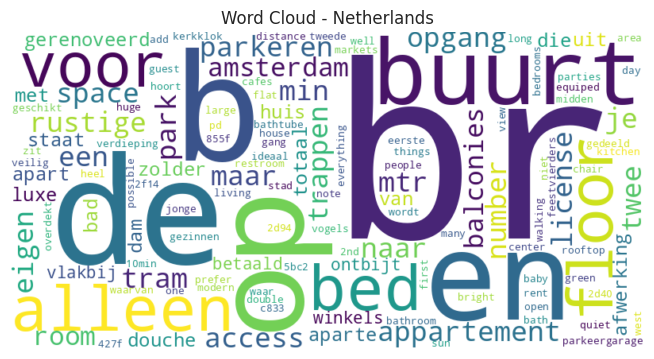

In [ ]:

import nltk
from nltk.corpus import stopwords
from wordcloud import WordCloud


nltk.download('punkt')
nltk.download('stopwords')

# Pré-processamento de texto
stop_words = set(stopwords.words('english'))

def preprocess_text(text):
    words = nltk.word_tokenize(text)
    words = [word.lower() for word in words if word.isalnum() and word not in stop_words]
    return ' '.join(words)

df['clean_description'] = df['description'].apply(preprocess_text)

# Criando nuvens de palavras usando as descrições dadas pelos anfitriões
plt.figure(figsize=(18, 8))
for neighborhood, group in df.groupby('neighbourhood'):
    wordcloud = WordCloud(width=800, height=400, background_color='white').generate(' '.join(group['clean_description']))
    plt.subplot(1, 2, 1 if neighborhood == 'Downtown' else 2)
    plt.imshow(wordcloud, interpolation='bilinear')
    plt.title(f'Word Cloud - {neighborhood}')
    plt.axis("off")


"Flat": Essa palavra é usada para descrever um apartamento em inglês.

"Amsterdam": Essa palavra indica que a nuvem de palavras é sobre apartamentos em Amsterdã.

"Quiet": Essa palavra indica que os apartamentos são geralmente silenciosos.


"Access": Essa palavra indica que os apartamentos têm fácil acesso a serviços e atrações.


"Park": Essa palavra indica que alguns apartamentos estão localizados perto de parques.


"Bathroom": Essa palavra indica que todos os apartamentos têm banheiro.

"Bed": Essa palavra indica que todos os apartamentos têm pelo menos um quarto.

"Closet": Essa palavra indica que alguns apartamentos têm armário.

"Kitchen": Essa palavra indica que todos os apartamentos têm cozinha.

"Living room": Essa palavra indica que todos os apartamentos têm sala de estar.


# SÍNTESE DA EDA


Fatores contribuintes para um preço relativamente alto

* Através da análise exploratória é possível afirmar que os bairros tem relação mútua com os preços , Tendo em vista , que os bairros



**O que podemos discernir sobre As características de cada bairro usando as descrições dadas pelos anfitriões?**


Em que épocas do ano os preços ficam mais altos ?

*Mês de abril*

**Qual é a taxa média de ocupação dos alojamentos do airbnb na Holanda?**

* 44.50%

**Quais áreas/ tipos de alojamentos são mais populares na Holanda?**


* Casa/apartamento inteiro (Entire home/apt).
Sala privativa (Private room).


**Quais são os bairros mais caros e mais baratos para alugar via airbnb na Holanda ?**


* Caros : Amsterdam, Noord-Holland, Netherlands   ,
Quais são as características mais populares dos alojamentos do airbnb?


# SÍNTESE DA EDA


**Fatores contribuintes para um preço relativamente alto**





O que podemos discernir sobre as características de cada bairro usando as descrições dadas pelos anfitriões?

* Através do processamento de linguagem natural, é possível identificar que as características mais citadas pelos anfitriões em suas descrições de apartamentos são:

Comodidade: representada pela palavra "silêncio", que indica que o apartamento é silencioso e tranquilo.

Localização: indicada pelas proximidades de parques e outros pontos de interesse.

Atributos: que compõem o apartamento, como a presença de banheiro, cozinha, quarto e outros cômodos.


Qual é o preço médio ?

* $223.04

Em que épocas do ano os preços ficam mais altos ?

* Abril

Esses preços tem relação com os bairros?

* Sim , Além das características .

Qual é a taxa média de ocupação dos alojamentos do airbnb na Holanda?

* 44.50%

Quais áreas/ tipos de alojamentos são mais populares na Holanda ?

* Os tipos de alojamentos mais populares são : Entire home/apt, hotel room,private room, shared room.



* Áreas mais populares: Noord-Holland, Netherlands  3659

 North Holland, Netherlands  515

  Amsterdam, NH, Netherlands 184



Quais são os bairros mais caros e mais baratos para alugar via airbnb na Holanda ?

*  De acordo com o gráfico, os bairros mais caros de Amsterdã são:

Centrum-West: Este bairro é o centro histórico de Amsterdã e abriga atrações turísticas populares, como o Rijksmuseum, o Museu Van Gogh e a Casa de Anne Frank.

Centrum-Oost: Este bairro fica a leste do centro histórico e abriga a Estação Central de Amsterdã, o distrito de moda de Jordaan e o Museu Stedelijk.

Zuid: Este bairro fica ao sul do centro histórico e abriga o Museu Van Gogh, o Vondelpark e o distrito de moda de De Pijp.



Quais são as características mais populares dos alojamentos do airbnb?


* Baseado na  primeira nuvem de palavra feita nessa EDA essas são as características :

Apartamento: Esta palavra é o termo mais comumente usado para descrever um imóvel residencial.

Amsterdam: Esta palavra indica que o conjunto de dados é sobre apartamentos em Amsterdã.

Quieto: Esta palavra indica que os apartamentos são geralmente silenciosos e tranquilos.

Acesso: Esta palavra indica que os apartamentos têm fácil acesso a serviços e atrações.

Parque: Esta palavra indica que alguns apartamentos estão localizados perto de parques.

Banheiro: Esta palavra indica que todos os apartamentos têm banheiro.

Quarto: Esta palavra indica que todos os apartamentos têm pelo menos um quarto.

Armário: Esta palavra indica que alguns apartamentos têm armário.

Cozinha: Esta palavra indica que todos os apartamentos têm cozinha.

Sala de estar: Esta palavra indica que todos os apartamentos têm sala de estar.


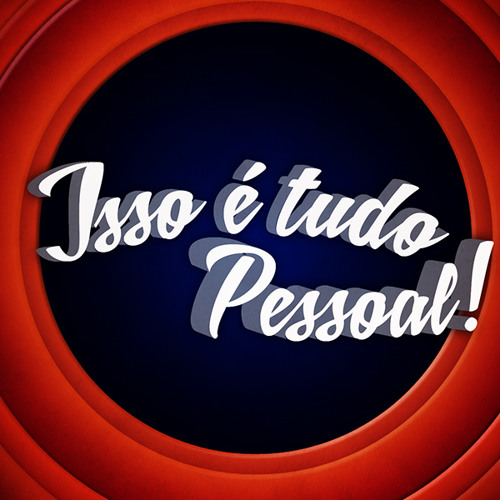